<a href="https://colab.research.google.com/github/amalazimroshan/safepass/blob/main/safepass_yolo.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!wget https://s3.eu-central-1.amazonaws.com/avg-kitti/data_scene_flow.zip
!wget https://s3.eu-central-1.amazonaws.com/avg-kitti/data_scene_flow_calib.zip
!unzip /content/data_scene_flow.zip
!unzip /content/data_scene_flow_calib.zip

--2024-10-29 16:03:25--  https://s3.eu-central-1.amazonaws.com/avg-kitti/data_scene_flow.zip
Resolving s3.eu-central-1.amazonaws.com (s3.eu-central-1.amazonaws.com)... 3.5.134.79, 3.5.137.197, 52.219.171.129, ...
Connecting to s3.eu-central-1.amazonaws.com (s3.eu-central-1.amazonaws.com)|3.5.134.79|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1681488619 (1.6G) [application/zip]
Saving to: ‘data_scene_flow.zip’

data_scene_flow.zip 100%[===================>]   1.57G  28.4MB/s    in 65s     

2024-10-29 16:04:30 (24.8 MB/s) - ‘data_scene_flow.zip’ saved [1681488619/1681488619]

--2024-10-29 16:04:30--  https://s3.eu-central-1.amazonaws.com/avg-kitti/data_scene_flow_calib.zip
Resolving s3.eu-central-1.amazonaws.com (s3.eu-central-1.amazonaws.com)... 3.5.137.186, 52.219.171.169, 52.219.209.9, ...
Connecting to s3.eu-central-1.amazonaws.com (s3.eu-central-1.amazonaws.com)|3.5.137.186|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 16310

In [4]:
!pip install filterpy
!pip install scikit-image
!pip install lap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.0/178.0 kB 4.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for filterpy: filename=filterpy-1.4.5-py3-none-any.whl size=110458 sha256=70cfe56ddd7e0d7efcb2da186d873860eaba99fe7c04859370b1954519787a45
  Stored in directory: /root/.cache/pip/wheels/0f/0c/ea/218f266af4ad626897562199fbbcba521b8497303200186102
Successfully built filterpy
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.5/1.5 MB 17.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  error: subprocess-exited-with-error
  
  × python setup.py bdist_wheel did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  ERROR: Failed building wheel for lap
  Running setup.py clean for lap
Failed to build lap
ERROR: ERROR: Failed to build installable wheels for some pyproject.toml based projects (lap)


In [5]:
from sort import Sort

In [13]:
import cv2
import torch
import numpy as np
from pathlib import Path
import pandas as pd
import time


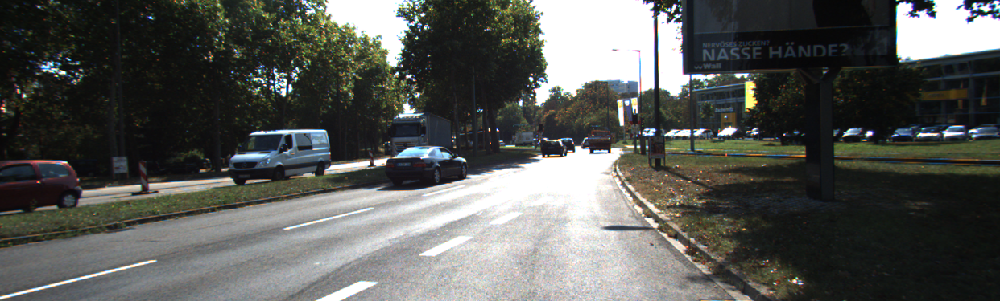

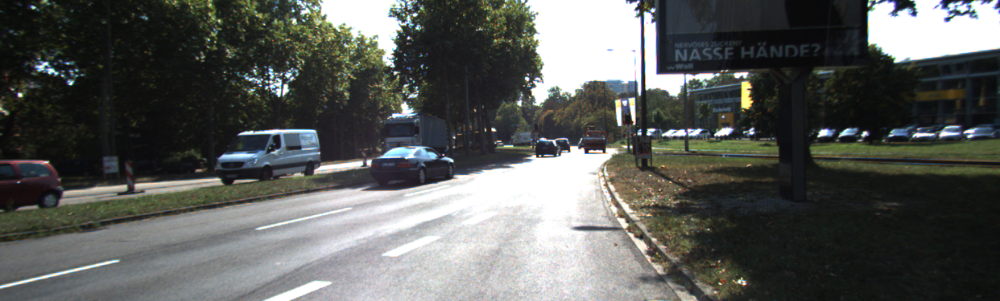

In [7]:
import os
from google.colab.patches import cv2_imshow
# Load the image file
image_path_left = '/content/training/image_2/000089_11.png'
image_path_right = '/content/training/image_3/000089_11.png'

# Read the images using cv2.imread
left_image = cv2.imread(image_path_left)
right_image = cv2.imread(image_path_right)

# Display the images
cv2_imshow(left_image)
cv2_imshow(right_image)

In [8]:
class KITTIVehicleDetector:
  def __init__(self):
    self.model = torch.hub.load('ultralytics/yolov5','yolov5s',pretrained=True)
    self.model.classes = [2,5,7]
    self.model.conf = 0.25

    self.device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    self.model.to(self.device)

  def detect_vehicles(self, image):
    results = self.model(image)
    print('results')
    print(results)
    return results.xyxy[0].cpu().numpy()


In [9]:
class KITTIDataLoader:
  def __init__(self, base_path):
    self.base_path = Path(base_path)
    self.left_image_dir = self.base_path / 'image_2'
    self.right_image_dir = self.base_path / 'image_3'
    self.left_images = sorted(self.left_image_dir.glob('*.png'))
    self.right_images = sorted(self.right_image_dir.glob('*.png'))

  def __len__(self):
    return len(self.left_images)

  def get_stereo_pair(self, idx):
    if idx>= len(self):
      return None, None
    left_img = cv2.imread(str(self.left_images[idx]))
    right_img = cv2.imread(str(self.right_images[idx]))
    return left_img, right_img

In [10]:
class StereoProcessor:
  def __init__(self):
    self.focal_length = 721.5377
    self.baseline = 0.54

    self.stereo = cv2.StereoSGBM_create(
        minDisparity=0,
        numDisparities=128,
        blockSize=5,
        P1=8 * 3 * 5 ** 2,
        P2=32 * 3 * 5 ** 2,
        disp12MaxDiff=1,
        uniquenessRatio=10,
        speckleWindowSize=100,
        speckleRange=32,
        mode=cv2.STEREO_SGBM_MODE_SGBM_3WAY
    )

  def compute_disparity(self, left_img, right_img):
    left_gray = cv2.cvtColor(left_img, cv2.COLOR_BGR2GRAY)
    right_gray = cv2.cvtColor(right_img, cv2.COLOR_BGR2GRAY)

    disparity = self.stereo.compute(left_gray, right_gray).astype(np.float32) / 16.0
    return disparity

  def calculate_distance(self, disparity_map, bbox):
    x1, y1, x2, y2 = map(int, bbox[:4])
    roi_disparity = disparity_map[y1:y2, x1:x2]
    valid_disparities = roi_disparity[roi_disparity > 0]
    if len(valid_disparities) == 0:
      return None

    median_disparity = np.median(valid_disparities)
    distance = (self.focal_length * self.baseline) / median_disparity
    return distance

In [20]:
class VehicleTracker:
  def __init__(self):
    self.tracker = Sort(max_age=20, min_hits=3, iou_threshold=0.3)

    self.vehicle_history = {}
    self.history_max_len = 5

  def update(self, detections, frame_time):
    if len(detections) == 0:
      return np.empty((0,5))
    return self.tracker.update(detections[:,:5])

  def update_vehicle_history(self, track_id, position, distance, timestamp):
    if track_id not in self.vehicle_history:
      self.vehicle_history[track_id] = []

    self.vehicle_history[track_id].append((timestamp,position,distance))

    if len(self.vehicle_history[track_id]) > self.history_max_len:
      self.vehicle_history[track_id].pop(0)

  def calculate_speed(self, track_id):
    history = self.vehicle_history.get(track_id)
    if not history or len(history) < 2:
      return None

    prev_time, prev_pos, prev_dist = history[-2]
    curr_time, curr_pos, curr_dist = history[-1]

    time_diff = curr_time - prev_time
    if time_diff == 0:
      return None

    dx = curr_pos[0] - prev_pos[0]
    dy = curr_pos[1] - prev_pos[1]
    dz = prev_dist - curr_dist

    pixel_to_meter = prev_dist / 721.5377
    dx_meters = dx * pixel_to_meter
    dy_meters = dy * pixel_to_meter

    displacement = np.sqrt(dx_meters**2 + dy_meters**2 + dz**2)
    speed = displacement/time_diff

    return speed

In [32]:
class VehicleDetectionAndTracking:
  def __init__(self):
    self.detector = KITTIVehicleDetector()
    self.stereo = StereoProcessor()
    self.tracker = VehicleTracker()

  def process_frame(self, left_img, right_img, timestamp):
    disparity_map = self.stereo.compute_disparity(left_img, right_img)
    detections = self.detector.detect_vehicles(left_img)
    tracks = self.tracker.update(detections, timestamp)

    results = []
    for track in tracks:
      track_id = int(track[4])
      bbox = track[:4]

      distance = self.stereo.calculate_distance(disparity_map, bbox)
      if distance is None:
        continue

      center_x = (bbox[0] + bbox[2])/2
      center_y = (bbox[1] + bbox[3])/2
      position = np.array([center_x, center_y])

      self.tracker.update_vehicle_history(track_id, position, distance, timestamp)
      speed = self.tracker.calculate_speed(track_id)

      results.append({
          'track_id':track_id,
          'bbox':bbox,
          'distance': distance,
          'speed': speed
      })

    return results, disparity_map

  def visualizeResult(self,image, results, disparity_map=None):
    vis_img = image.copy()

    color_map = {}

    for result in results:
      track_id = result['track_id']
      bbox = result['bbox']
      distance = result['distance']
      speed = result['speed']

      if track_id not in color_map:
        color_map[track_id] = tuple(map(int, np.random.randint(0,255,3)))
      color = color_map[track_id]

      x1, y1, x2, y2 = map(int, bbox)
      cv2.rectangle(vis_img, (x1, y1), (x2, y2), color, 2)

      label = f"ID:{track_id} D:{distance:.1f}m"
      if speed is not None:
        label += f" {speed:.1f}m/s"

      cv2.putText(vis_img, label, (x1,y1-10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, 2)

      history = self.tracker.vehicle_history.get(track_id,[])
      if len(history) > 1:
        points = np.array([ (int(pos[1]), int(pos[1])) for _, pos, _ in history], np.int32)
        cv2.polylines(vis_img, [points], False, color, 2)

    return vis_img

Using cache found in /root/.cache/torch/hub/ultralytics_yolov5_master
YOLOv5 🚀 2024-10-29 Python-3.10.12 torch-2.5.0+cu121 CPU

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
Adding AutoShape... 


<class 'numpy.ndarray'>


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


results
image 1/1: 375x1242 6 cars
Speed: 4.4ms pre-process, 172.7ms inference, 1.3ms NMS per image at shape (1, 3, 224, 640)


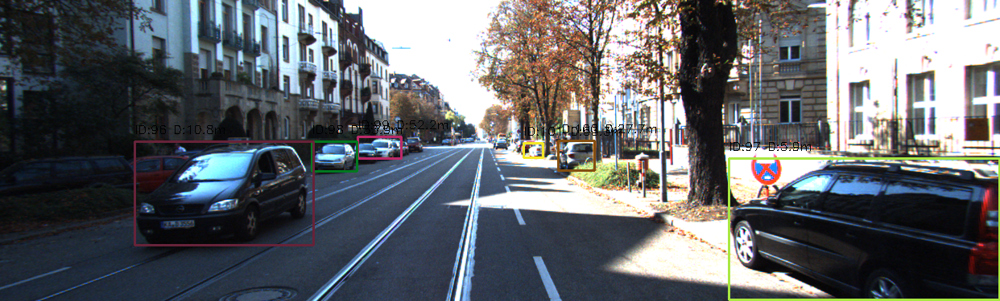

<class 'numpy.ndarray'>


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


results
image 1/1: 375x1242 8 cars
Speed: 2.7ms pre-process, 306.7ms inference, 3.4ms NMS per image at shape (1, 3, 224, 640)


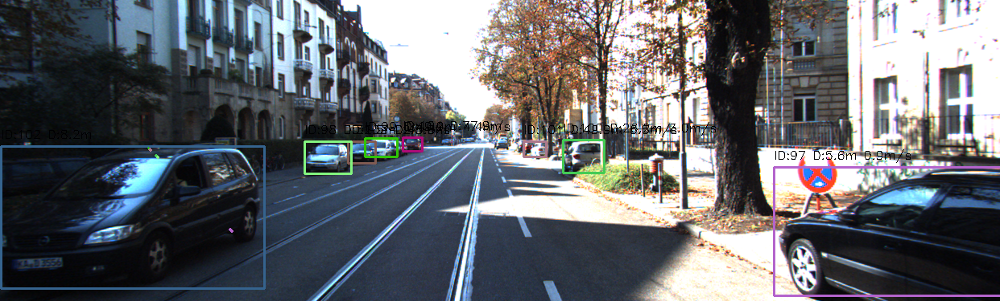

<class 'numpy.ndarray'>


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


results
image 1/1: 375x1242 2 cars
Speed: 3.1ms pre-process, 271.1ms inference, 1.5ms NMS per image at shape (1, 3, 224, 640)


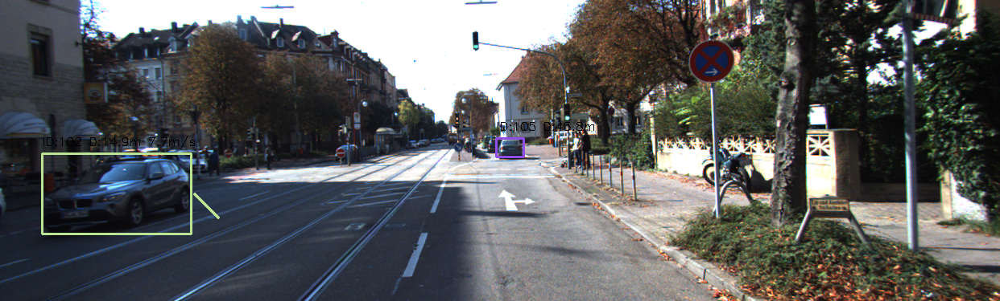

<class 'numpy.ndarray'>


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


results
image 1/1: 375x1242 6 cars
Speed: 3.1ms pre-process, 298.0ms inference, 3.4ms NMS per image at shape (1, 3, 224, 640)


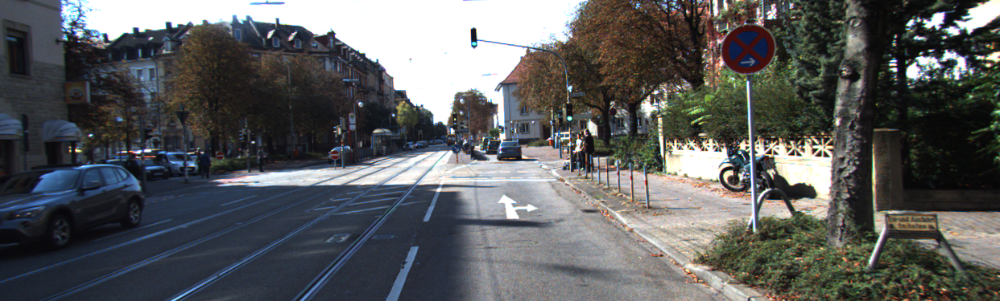

<class 'numpy.ndarray'>


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


results
image 1/1: 375x1242 4 cars
Speed: 4.5ms pre-process, 255.3ms inference, 4.6ms NMS per image at shape (1, 3, 224, 640)


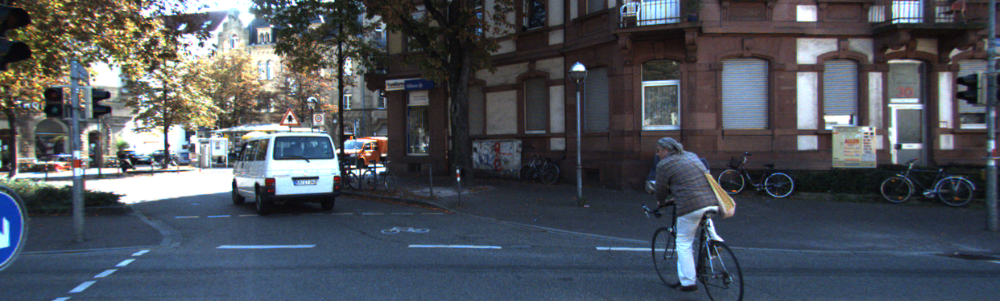

<class 'numpy.ndarray'>


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


results
image 1/1: 375x1242 2 cars, 1 truck
Speed: 2.8ms pre-process, 289.1ms inference, 5.2ms NMS per image at shape (1, 3, 224, 640)


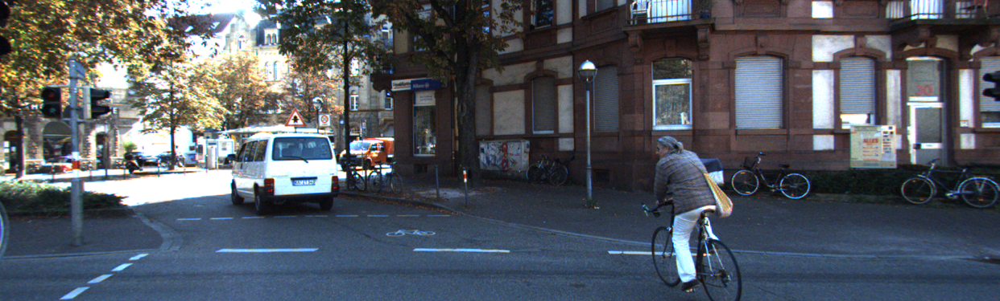

<class 'numpy.ndarray'>


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


results
image 1/1: 375x1242 2 cars, 2 buss, 1 truck
Speed: 4.8ms pre-process, 302.1ms inference, 2.2ms NMS per image at shape (1, 3, 224, 640)


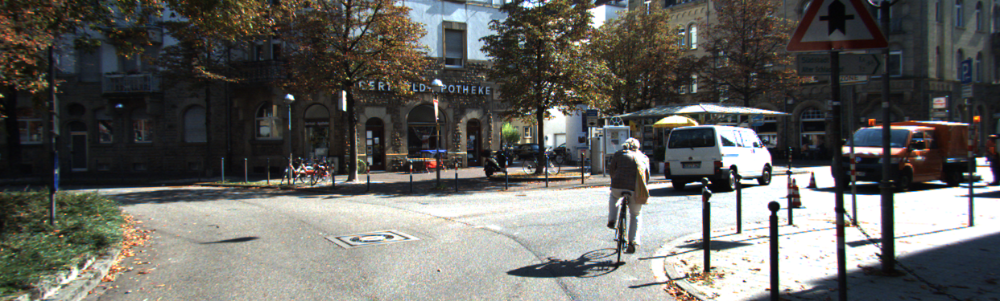

<class 'numpy.ndarray'>


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


results
image 1/1: 375x1242 2 cars
Speed: 3.1ms pre-process, 273.7ms inference, 2.0ms NMS per image at shape (1, 3, 224, 640)


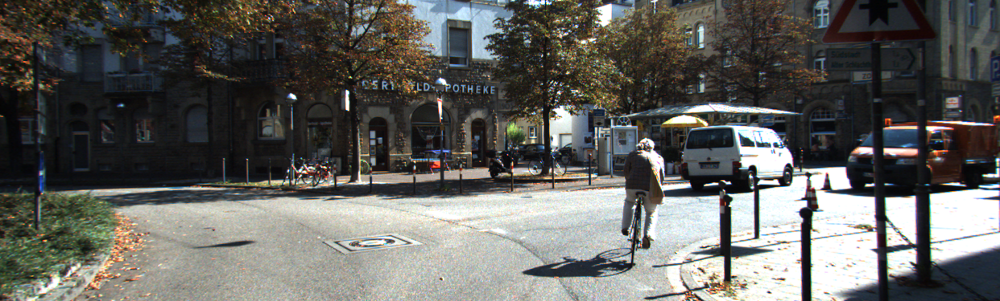

<class 'numpy.ndarray'>


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


results
image 1/1: 375x1242 11 cars, 2 trucks
Speed: 3.2ms pre-process, 258.6ms inference, 2.2ms NMS per image at shape (1, 3, 224, 640)


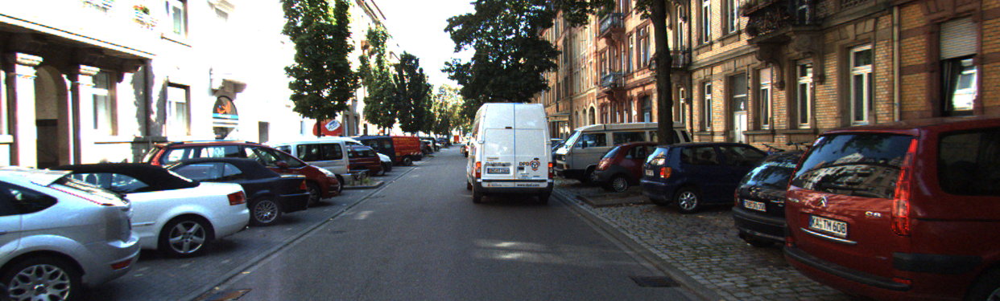

<class 'numpy.ndarray'>


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


results
image 1/1: 375x1242 13 cars, 1 truck
Speed: 2.8ms pre-process, 263.9ms inference, 1.8ms NMS per image at shape (1, 3, 224, 640)


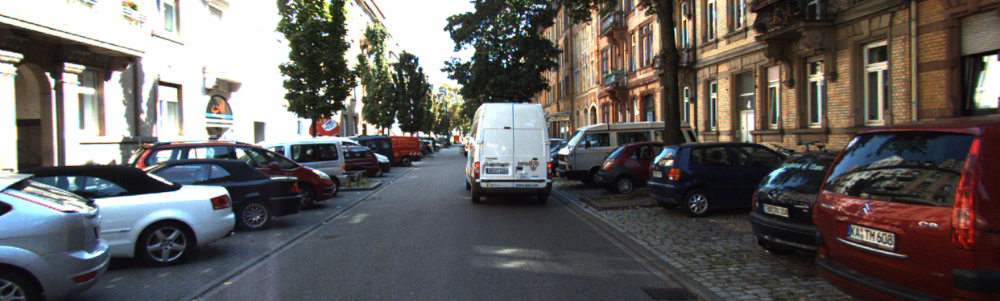

<class 'numpy.ndarray'>


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


results
image 1/1: 375x1242 10 cars, 2 trucks
Speed: 3.1ms pre-process, 287.3ms inference, 2.2ms NMS per image at shape (1, 3, 224, 640)


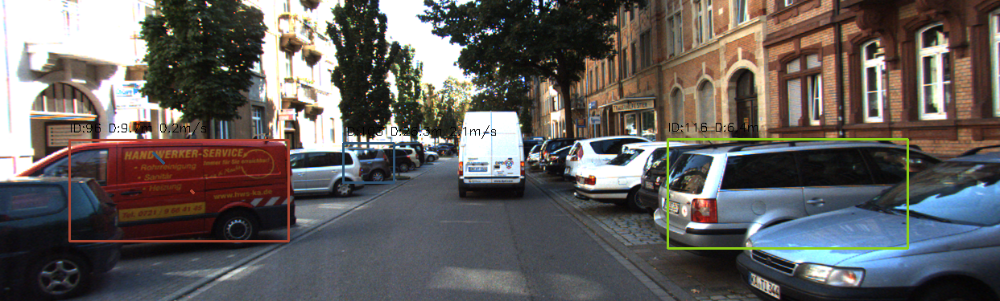

<class 'numpy.ndarray'>


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


results
image 1/1: 375x1242 10 cars, 2 trucks
Speed: 3.0ms pre-process, 252.1ms inference, 1.8ms NMS per image at shape (1, 3, 224, 640)


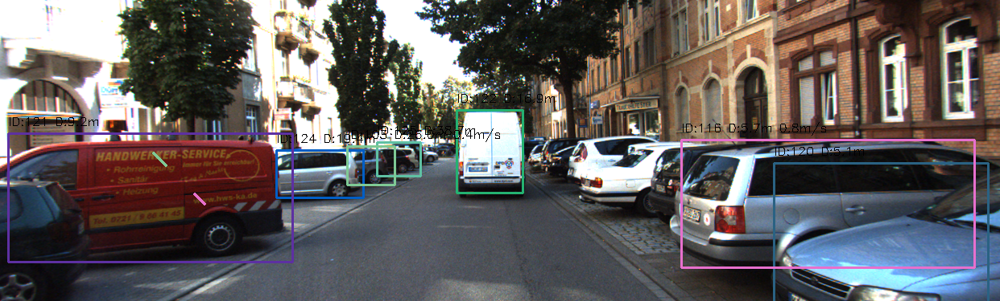

<class 'numpy.ndarray'>


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


results
image 1/1: 375x1242 10 cars, 1 truck
Speed: 2.6ms pre-process, 273.2ms inference, 3.3ms NMS per image at shape (1, 3, 224, 640)


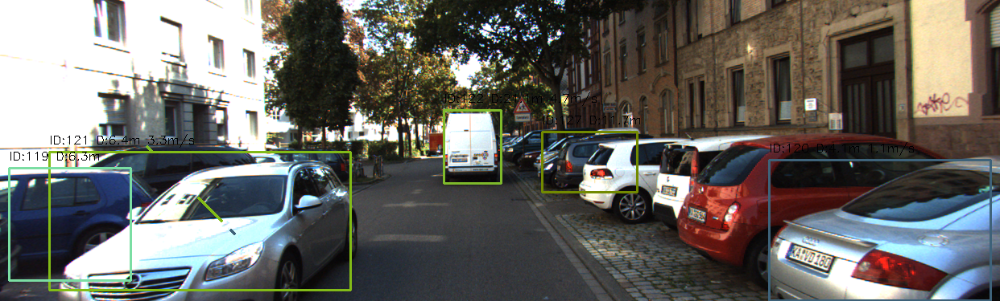

<class 'numpy.ndarray'>


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


results
image 1/1: 375x1242 10 cars, 1 truck
Speed: 2.6ms pre-process, 324.7ms inference, 3.7ms NMS per image at shape (1, 3, 224, 640)


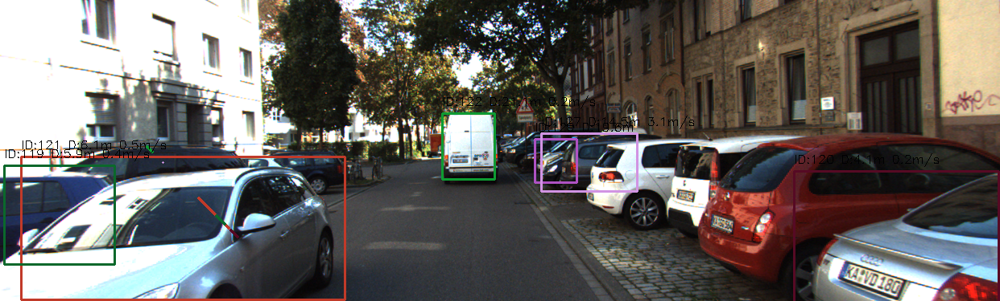

<class 'numpy.ndarray'>


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


results
image 1/1: 375x1242 3 cars, 1 truck
Speed: 3.5ms pre-process, 289.2ms inference, 2.0ms NMS per image at shape (1, 3, 224, 640)


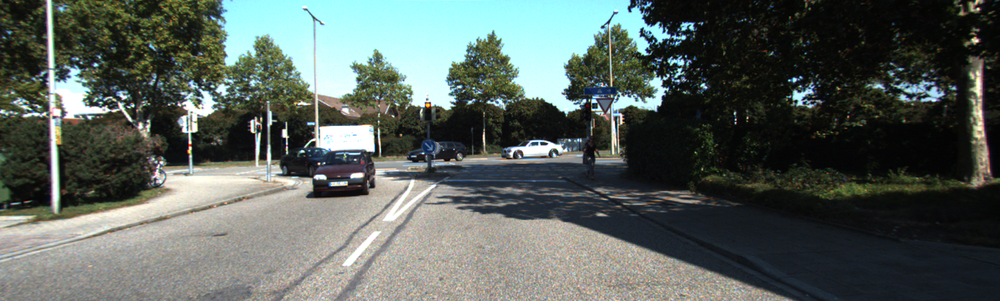

<class 'numpy.ndarray'>


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


results
image 1/1: 375x1242 2 cars, 1 truck
Speed: 3.1ms pre-process, 261.1ms inference, 3.2ms NMS per image at shape (1, 3, 224, 640)


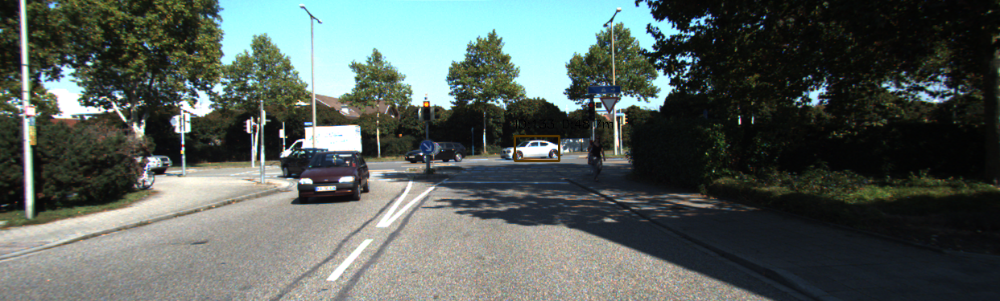

<class 'numpy.ndarray'>


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


results
image 1/1: 375x1242 5 cars
Speed: 3.0ms pre-process, 282.0ms inference, 3.3ms NMS per image at shape (1, 3, 224, 640)


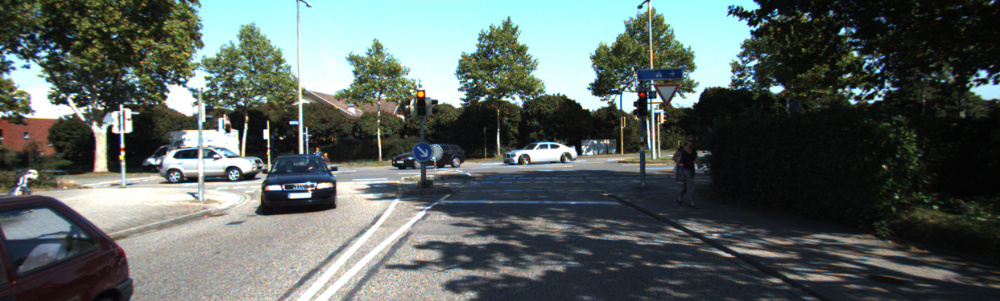

<class 'numpy.ndarray'>


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


results
image 1/1: 375x1242 5 cars
Speed: 3.1ms pre-process, 260.1ms inference, 3.2ms NMS per image at shape (1, 3, 224, 640)


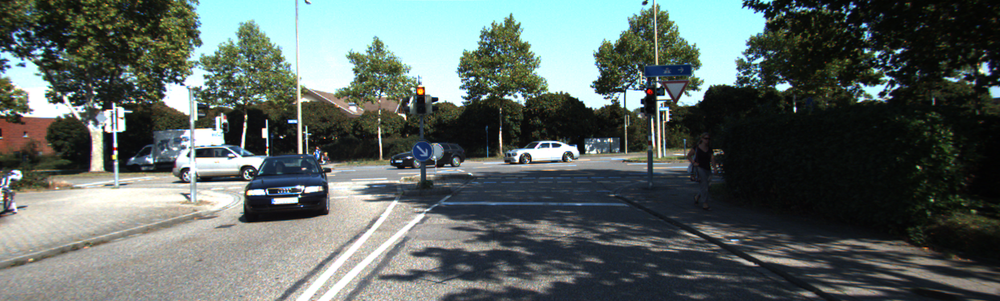

<class 'numpy.ndarray'>


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


results
image 1/1: 375x1242 2 cars
Speed: 3.4ms pre-process, 307.3ms inference, 1.9ms NMS per image at shape (1, 3, 224, 640)


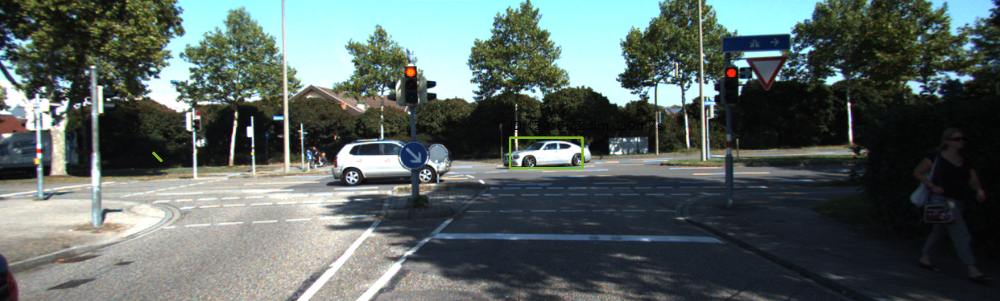

<class 'numpy.ndarray'>


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


results
image 1/1: 375x1242 3 cars
Speed: 3.3ms pre-process, 272.3ms inference, 3.9ms NMS per image at shape (1, 3, 224, 640)


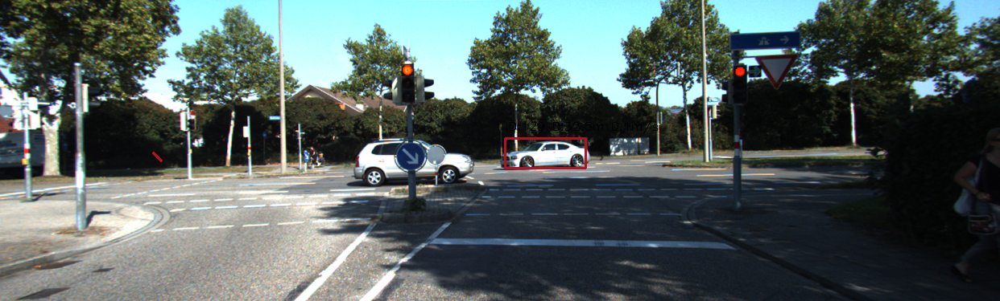

<class 'numpy.ndarray'>


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


results
image 1/1: 375x1242 3 cars
Speed: 3.8ms pre-process, 277.8ms inference, 3.9ms NMS per image at shape (1, 3, 224, 640)


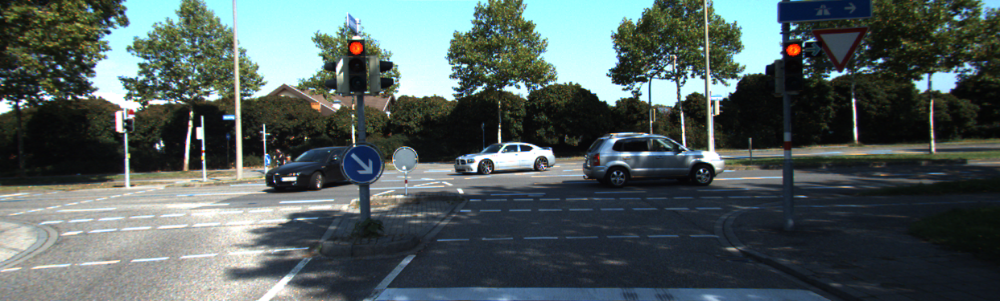

In [34]:
system = VehicleDetectionAndTracking()
data_loader = KITTIDataLoader('/content/training')

start_time = time.time()

# '/content/training/image_2/000089_11.png
for idx in range(len(data_loader)):
  if idx > 20:
    break
  left_img, right_img = data_loader.get_stereo_pair(idx)
  if left_img is None or right_img is None:
    break

  print(type(left_img))
  current_time = time.time() - start_time
  results, disparity_map = system.process_frame(left_img, right_img, current_time)
  vis_image = system.visualizeResult(left_img, results, disparity_map)
  cv2_imshow(vis_image)


  # visualization_img = left_img.copy()

  # for det in detections:
  #   distance = stereo_processor.calculate_distance(disparity_map, det)
  #   x1, y1, x2, y2, conf, cls = det
  #   x1, y1, x2, y2 = map(int, [x1, y1, x2, y2])

  #   cv2.rectangle(visualization_img, (x1,y1), (x2, y2), (0,255,0), 2)
  #   label = f'Vehicle {conf:.2f}'
  #   if distance is not None:
  #     label += f'Dist: {distance:.1f}m'
  #   cv2.putText(visualization_img, label, (x1, y1-10),
  #               cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0,255,0), 2)
  # cv2_imshow(visualization_img)

  # norm_disparity = cv2.normalize(disparity_map, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)
  # cv2_imshow(norm_disparity)